In [1]:
import re
import pandas as pd
import matplotlib.pyplot as plt

Produtores – linhas após preprocess:
Well  Rows
 P16  1796
 P13  1817
 P15  1860
 P14  1903
 P11  1946
 P12  1979

Injetores – linhas após preprocess:
 Well  Rows
  I11     0
  I12     0
  I13     0
  I14     0
  I15     0
  I16     0
  I17     0
I11-W  1538
I13-W  1538
I17-W  1538
I12-W  1730
I15-W  1752
I14-W  1774

Opções de plotagem:
{'colunas': ['Gas Rate SC', 'Oil Rate SC', 'Water Rate SC', 'Well Bottom-hole Pressure'], 'produtores': ['P11', 'P12', 'P13', 'P14', 'P15', 'P16'], 'injetores': ['I11', 'I11-W', 'I12', 'I12-W', 'I13', 'I13-W', 'I14', 'I14-W', 'I15', 'I15-W', 'I16', 'I17', 'I17-W']}


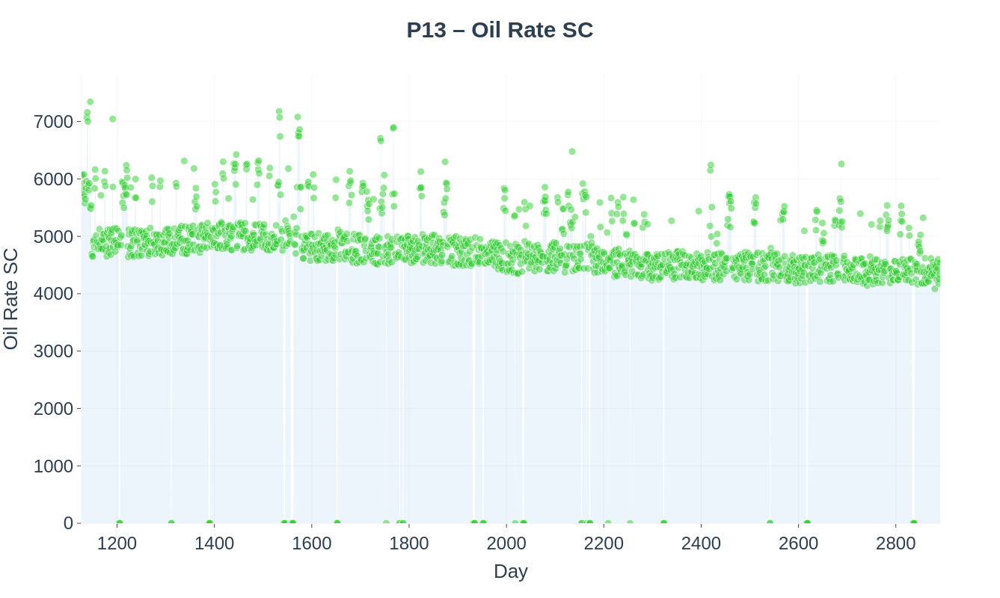

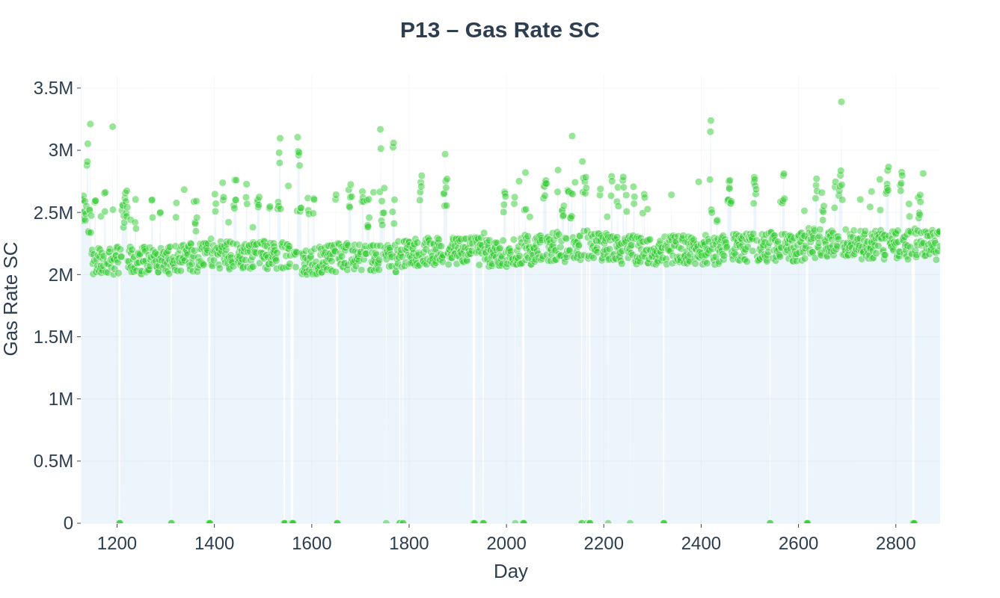

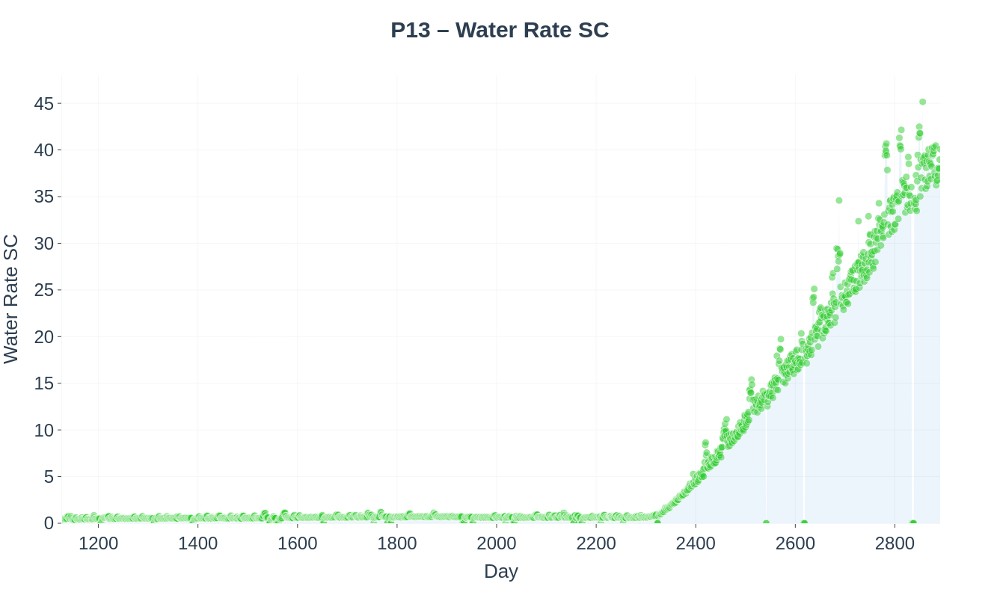

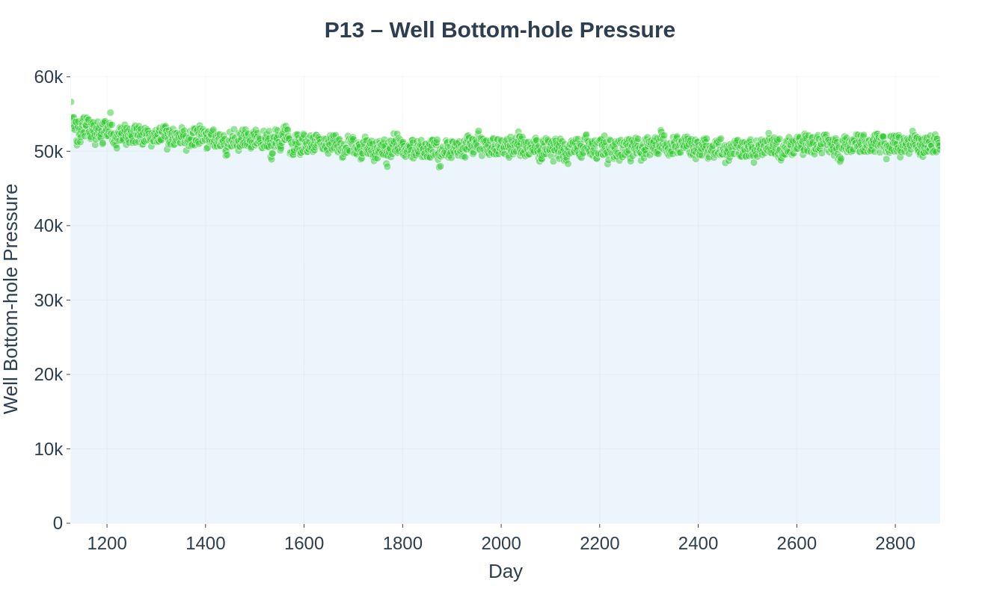

Salvo em Well_P13_UNISIM-IV.csv


In [2]:
"""well_data_refactor.py
-----------------------
Pipeline refatorado para leitura, pré‑processamento e plotagem de dados de poços de
produção e injeção.

Mudanças principais nesta versão:
• **Pivot único (Oil Rate SC)** para alinhar cronologia de cada poço.
• `preprocess_dataframe` agora trunca o DataFrame no primeiro dia de produção
  (>0) da coluna pivô e propaga o recorte para todas as colunas.
• Função utilitária `summarize_lengths` imprime/retorna nº de linhas por poço.
• `main()` demonstra o fluxo completo com resumo de tamanhos após preprocess.

Dependências: pandas, numpy, matplotlib, plotly.
"""

from __future__ import annotations

import re
from pathlib import Path
import plotly.graph_objects as go
from typing import Dict, Iterable, List, Optional, Sequence

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

try:
    from forecast_pipeline.plotting import plot_series  # type: ignore

    _HAS_PIPELINE = True
except ImportError:
    _HAS_PIPELINE = False

__all__ = [
    "parse_well_file",
    "load_well_files",
    "preprocess_dataframe",
    "summarize_lengths",
    "build_plot_options",
    "plot_by_well",
    "plot_by_column",
    "plot_all_columns",
]

DEFAULT_PIVOT = "Oil Rate SC"

COLOR_PRIMARY = '#0077B6'  # Strong Blue (Star Command Blue)
COLOR_SECONDARY = '#F94144' # Strong Red (Imperial Red)
COLOR_ACCENT_FILL = 'rgba(249, 65, 68, 0.1)' # Very subtle red fill
COLOR_TEXT = '#2c3e50'      # Midnight Blue (Slightly softer dark)
COLOR_GRID = 'rgba(189, 195, 199, 0.4)' # Silver Sand / Light Gray
FONT_FAMILY = "Lato, Arial, sans-serif" # Modern, clean font (Lato preferred if available)

COLOR_PRIMARY     = "#32CD32"            # LimeGreen — destaca produção
COLOR_SECONDARY   = "#4A90E2"            # Soft Blue — para comparação ou gás
COLOR_ACCENT_FILL = "rgba(74, 144, 226, 0.1)"  # fill azul suave
COLOR_TEXT        = "#2C3E50"            # Dark Slate — boa legibilidade
COLOR_GRID        = "rgba(236, 240, 241, 0.5)" # Light Gray — grade sutil
FONT_FAMILY       = "Lato, Arial, sans-serif"


# ---------------------------------------------------------------------------
# Parsing helpers
# ---------------------------------------------------------------------------

_TAG_RE = re.compile(r"'([^']+)'\s*$")


def _find_header(lines: List[str], expected: Sequence[str]) -> tuple[int, List[str]]:
    tag_pattern = re.compile(r"'([^']+)'")
    for idx, line in enumerate(lines):
        if all(tok in line for tok in expected):
            return idx, tag_pattern.findall(line)
    raise ValueError("Header not found – expected tokens: " + ", ".join(expected))


def parse_well_file(lines: List[str], *, is_producer: bool) -> Dict[str, pd.DataFrame]:
    """Parseia arquivo de produção ou injeção para dict[tag -> DataFrame]."""

    expected_tokens = (
        ["Oil Rate SC"] if is_producer else ["Water Rate SC", "Well Bottom-hole Pressure"]
    )
    header_idx, header_names = _find_header(lines, expected_tokens)

    pos = header_idx + 3  # unidades + n_wells + (possível) linha vazia
    dfs: Dict[str, pd.DataFrame] = {}

    while pos < len(lines):
        line = lines[pos].strip()
        pos += 1
        if not line:
            continue
        tag_match = _TAG_RE.match(line)
        if not tag_match:
            continue
        tag = tag_match.group(1)

        data: list[list[str]] = []
        while pos < len(lines):
            nxt = lines[pos].strip()
            if not nxt:
                pos += 1
                continue
            if _TAG_RE.match(nxt):
                break  # novo poço
            parts = nxt.split()
            if len(parts) >= len(header_names) + 1:  # Day + colunas
                data.append(parts[: len(header_names) + 1])
            pos += 1

        df = pd.DataFrame(data, columns=["Day", *header_names])
        df = df.apply(pd.to_numeric, errors="coerce")
        dfs[tag] = df

    return dfs


# ---------------------------------------------------------------------------
# I/O de alto nível
# ---------------------------------------------------------------------------

def load_well_files(prod_path: Path | str, inj_path: Path | str) -> tuple[dict, dict]:
    with open(prod_path, "r", encoding="utf-8", errors="ignore") as f:
        prod_lines = f.readlines()
    with open(inj_path, "r", encoding="utf-8", errors="ignore") as f:
        inj_lines = f.readlines()

    prod_dfs = parse_well_file(prod_lines, is_producer=True)
    inj_dfs = parse_well_file(inj_lines, is_producer=False)
    return prod_dfs, inj_dfs


# ---------------------------------------------------------------------------
# Pré‑processamento
# ---------------------------------------------------------------------------

def preprocess_dataframe(
    df: pd.DataFrame,
    *,
    day_threshold: int = 500,
    pivot: str = DEFAULT_PIVOT,
) -> pd.DataFrame:
    """Filtra `Day` > threshold e alinha no 1º valor não‑zero da coluna pivô.

    Todas as colunas herdam o recorte temporal, garantindo sincronismo.
    """
    if pivot not in df.columns:
        pivot = 'Water Rate SC'

    filtered = df[df["Day"] > day_threshold].copy()

    # índice do primeiro dia com produção > 0 na coluna pivô
    mask_nonzero = filtered[pivot] != 0
    if not mask_nonzero.any():
        return filtered.iloc[0:0].copy()  # nada a produzir

    first_idx = mask_nonzero.idxmax()
    aligned = filtered.loc[first_idx:].reset_index(drop=True)
    return aligned


def _preprocess_all(
    well_dfs: Dict[str, pd.DataFrame],
    *,
    day_threshold: int = 500,
    pivot: str = DEFAULT_PIVOT,
) -> None:
    for tag, df in well_dfs.items():
        well_dfs[tag] = preprocess_dataframe(df, day_threshold=day_threshold, pivot=pivot)


# ---------------------------------------------------------------------------
# Resumo estrutural
# ---------------------------------------------------------------------------

def summarize_lengths(well_dfs: Dict[str, pd.DataFrame]) -> pd.DataFrame:
    """Retorna/printa número de linhas por poço (útil para checar alinhamento)."""

    summary = pd.DataFrame(
        [(tag, len(df)) for tag, df in well_dfs.items()],
        columns=["Well", "Rows"],
    ).sort_values("Rows")

    print(summary.to_string(index=False))
    return summary


# ---------------------------------------------------------------------------
# Plot helpers
# ---------------------------------------------------------------------------

def build_plot_options(prod_dfs: dict, inj_dfs: dict) -> dict:
    all_columns = set()
    for d in (prod_dfs, inj_dfs):
        for df in d.values():
            all_columns.update(df.columns.difference(["Day"]))

    return {
        "colunas": sorted(all_columns),
        "produtores": sorted(prod_dfs.keys()),
        "injetores": sorted(inj_dfs.keys()),
    }


# --- plotagem base ---------------------------------------------------------

def _plot_matplotlib(x: np.ndarray, y: np.ndarray, *, title: str, ylabel: str, label: str) -> None:
    plt.figure(figsize=(10, 5))
    plt.plot(x, y, label=label)
    plt.title(title)
    plt.xlabel("Day")
    plt.ylabel(ylabel)
    plt.grid(True)
    plt.legend()
    plt.show()


def _plot_series_wrapper(series: pd.Series, *, well: str, col: str) -> None:
    if _HAS_PIPELINE:
        plot_series(truth=series.values, mean_curve=series.values, title=col, well=well)
    else:
        _plot_matplotlib(series.index.values, series.values, title=f"{well} – {col}", ylabel=col, label=col)


# --- API pública de plotagem ----------------------------------------------

def plot_by_well(
    well_dfs: Dict[str, pd.DataFrame],
    *,
    well: str,
    columns: Optional[Iterable[str]] = None,
) -> None:
    df = well_dfs.get(well)
    if df is None:
        raise KeyError(f"Well '{well}' not found.")

    cols = columns or df.columns.difference(["Day"])
    for col in cols:
        if col not in df.columns:
            print(f"[warn] coluna '{col}' inexistente em {well}")
            continue
        _plot_series_wrapper(df[col].dropna(), well=well, col=col)



def plot_by_column(
    well_dfs: Dict[str, pd.DataFrame],
    *,
    column: str,
    wells: Optional[Iterable[str]] = None,
) -> None:
    wells_iter = wells or well_dfs.keys()

    for well in wells_iter:
        df = well_dfs.get(well)
        if df is None or column not in df.columns:
            continue
        _plot_series_wrapper(df[column].dropna(), well=well, col=column)



def plot_all_columns(
    well_dfs: Dict[str, pd.DataFrame],
    *,
    columns_subset: Optional[Sequence[str]] = None,
) -> None:
    sample_df = next(iter(well_dfs.values()))
    target_cols = columns_subset or sample_df.columns.difference(["Day"])

    for col in target_cols:
        plot_by_column(well_dfs, column=col)


def plot_by_well_advanced(
    well_dfs: Dict[str, pd.DataFrame],
    *,
    well: str,
    columns: Optional[Iterable[str]] = None,
) -> None:
    """
    Plota séries temporais para um poço específico com visual profissional e aprimorado.
    """
    df = well_dfs.get(well)
    if df is None:
        raise KeyError(f"Well '{well}' not found.")

    cols = columns or [c for c in df.columns if c != "Day"]

    for col in cols:
        if col not in df.columns:
            print(f"[warn] coluna '{col}' inexistente em {well}")
            continue

        mask = df[col].notna()
        y = df.loc[mask, col].values
        x = df.loc[mask, "Day"] if "Day" in df.columns else np.arange(len(y))

        fig = go.Figure()

        fig.add_trace(go.Scatter(
            x=x,
            y=y,
            mode="markers",
            marker=dict(
                symbol="circle",
                size=10,
                color=COLOR_PRIMARY,
                opacity=0.5,
                line=dict(color="white", width=1)
            ),
            name=col,
            line=dict(color=COLOR_PRIMARY, width=2),
            fill="tozeroy",
            fillcolor=COLOR_ACCENT_FILL,
            hovertemplate=(
                f"<b>{well} – {col}</b><br>"
                "Data: %{x}<br>"
                "Valor: %{y:.2f}<extra></extra>"
            )
        ))

        fig.update_layout(
            title=dict(
                text=f"<b>{well} – {col}</b>",
                x=0.5,
                xanchor="center",
                font=dict(size=30, family=FONT_FAMILY, color=COLOR_TEXT)
            ),
            legend=dict(
                orientation="h",
                x=0.5,
                y=-0.2,
                xanchor="center",
                font=dict(size=14, family=FONT_FAMILY)
            ),
            xaxis_title="Day",
            yaxis_title=col,
            font=dict(family=FONT_FAMILY, size=14, color=COLOR_TEXT),
            plot_bgcolor="white",
            paper_bgcolor="white",
            margin=dict(l=80, r=80, t=100, b=100),
            hovermode="x unified",
            width=1400,
            height=800,
        )

        fig.update_xaxes(
            gridcolor=COLOR_GRID,
            zeroline=False,
            showline=True,
            linecolor=COLOR_GRID,
            ticks="outside",
            tickfont=dict(size=24),
            title_font=dict(size=26)
        )
        fig.update_yaxes(
            gridcolor=COLOR_GRID,
            zeroline=False,
            showline=True,
            linecolor=COLOR_GRID,
            ticks="outside",
            tickfont=dict(size=24),
            title_font=dict(size=26)
        )

        fig.show()


def save_by_well_csv(
    well_dfs: Dict[str, pd.DataFrame],
    *,
    well: str,
    columns: Optional[Iterable[str]] = None,
    name: str = ""
) -> str:
    """
    Salva as séries de um poço específico (Day + colunas selecionadas) em CSV.

    Args:
        well_dfs: dicionário tag → DataFrame já pré-processado.
        well: tag do poço a salvar (ex: "P13").
        columns: lista de colunas a incluir; por padrão todas exceto 'Day'.
        name: nome (sem extensão) do arquivo de saída; por padrão "well_<well>".

    Returns:
        O nome completo do arquivo gerado (com .csv).
    """
    df = well_dfs.get(well)
    if df is None:
        raise KeyError(f"Well '{well}' not found in the provided dataframes.")

    # escolha de colunas
    cols = list(columns) if columns is not None else [c for c in df.columns if c != "Day"]
    missing = set(cols) - set(df.columns)
    if missing:
        raise KeyError(f"Columns {missing} not found in DataFrame for well '{well}'.")

    # prepara DataFrame de saída
    out_df = df.loc[:, ["Day", *cols]].copy()

    # define nome do arquivo
    base = name.strip() or f"well_{well}"
    filename = f"{base}.csv"

    # salva e retorna o nome
    out_df.to_csv(filename, index=False)
    return filename



# ---------------------------------------------------------------------------
# Exemplo de uso
# ---------------------------------------------------------------------------

def main() -> None:
    prod_dfs, inj_dfs = load_well_files("hist_prod_daily.txt", "hist_inj_daily.txt")

    _preprocess_all(prod_dfs)
    _preprocess_all(inj_dfs)

    print("Produtores – linhas após preprocess:")
    summarize_lengths(prod_dfs)
    print("\nInjetores – linhas após preprocess:")
    summarize_lengths(inj_dfs)

    options = build_plot_options(prod_dfs, inj_dfs)
    print("\nOpções de plotagem:")
    print(options)

    WELL = "P13"

    # exemplos de plot
    plot_by_well_advanced(prod_dfs, well=WELL, columns=["Oil Rate SC", "Gas Rate SC", "Water Rate SC", 'Well Bottom-hole Pressure'])
    # plot_by_column(inj_dfs, column="Water Rate SC", wells=["I12-W", "I14-W"])

    fname = save_by_well_csv(
        prod_dfs,
        well=WELL,
        columns=["Oil Rate SC", "Gas Rate SC", "Water Rate SC", "Well Bottom-hole Pressure"],
        name=f"Well_{WELL}_UNISIM-IV"
    )
    print(f"Salvo em {fname}")



if __name__ == "__main__":
    main()


# Opções disponíveis:
# 'produtores': ['P11', 'P12', 'P13', 'P14', 'P15', 'P16']
# {'colunas': ['Gas Rate SC', 'Oil Rate SC', 'Water Rate SC', 'Well Bottom-hole Pressure'], 
# 'injetores': ['I11', 'I11-W', 'I12', 'I12-W', 'I13', 'I13-W', 'I14', 'I14-W', 'I15', 'I15-W', 'I16', 'I17', 'I17-W']}